In [ ]:
!apt install ffmpeg

Reading package lists... Done
Building dependency tree       
Reading state information... Done
ffmpeg is already the newest version (7:3.4.11-0ubuntu0.1).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 21 not upgraded.


In [ ]:
pip install spleeter

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.2/51.2 KB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.5/34.5 MB 36.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.3/77.3 KB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 KB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 KB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.6/80.6 KB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.9/54.9 KB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 60.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 74.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 79.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 85.7 MB/s eta 0:00:00
  Attempting uninstall

In [99]:
import spleeter
from spleeter.separator import Separator

from IPython.display import Audio, display
from IPython.display import HTML

import IPython.display as ipd
import sys

import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
from spleeter.audio.adapter import AudioAdapter

audio_loader = AudioAdapter.default()
sample_rate = 44100

In [60]:
from google.colab import files
uploaded = files.upload()

Saving LeTai - Как Же Так.mp3 to LeTai - Как Же Так.mp3


In [61]:
waveform, _ = audio_loader.load('beat1.mp3', sample_rate=sample_rate)
separator = Separator('spleeter:2stems')
prediction = separator.separate(waveform)

In [ ]:
prediction

{'vocals': array([[0.00195922, 0.00018958],
        [0.00218566, 0.00063579],
        [0.0022785 , 0.00112753],
        ...,
        [0.01508721, 0.02857759],
        [0.02060137, 0.02995223],
        [0.01663279, 0.01229953]], dtype=float32),
 'accompaniment': array([[ 0.18395217, -0.02615681],
        [ 0.29233986, -0.02883469],
        [ 0.32252115, -0.01058467],
        ...,
        [ 0.01849376,  0.01528093],
        [ 0.03355516,  0.02954805],
        [ 0.0275933 ,  0.03008745]], dtype=float32)}

In [ ]:
from IPython.display import Audio
Audio(prediction["vocals"][:, 0], rate=44100)

In [103]:
help(separator.separate_to_file)

Help on method separate_to_file in module spleeter.separator:

separate_to_file(audio_descriptor: Any, destination: str, audio_adapter: Union[spleeter.audio.adapter.AudioAdapter, NoneType] = None, offset: int = 0, duration: float = 600.0, codec: spleeter.audio.Codec = <Codec.WAV: 'wav'>, bitrate: str = '128k', filename_format: str = '{filename}/{instrument}.{codec}', synchronous: bool = True) -> None method of spleeter.separator.Separator instance
    Performs source separation and export result to file using
    given audio adapter.
    
    Filename format should be a Python formattable string that could
    use following parameters :
    
    - {instrument}
    - {filename}
    - {foldername}
    - {codec}.
    
    Parameters:
        audio_descriptor (AudioDescriptor):
            Describe song to separate, used by audio adapter to
            retrieve and load audio data, in case of file based
            audio adapter, such descriptor would be a file path.
        destination (s

In [49]:
separator.separate_to_file('beat1.mp3', "test")

In [69]:
files.view("test1/")

<IPython.core.display.Javascript object>

In [65]:
separator.separate_to_file('LeTai - Как Же Так.mp3', "test1")

In [66]:
waveform, _ = audio_loader.load('LeTai - Как Же Так.mp3', sample_rate=sample_rate)
separator = Separator('spleeter:2stems')
prediction_letai = separator.separate(waveform)

In [70]:
from IPython.display import Audio
Audio(prediction_letai["vocals"][:, 1], rate=44100)

In [78]:
ipd.Audio("test1/LeTai - Как Же Так/vocals.wav")

In [93]:
import librosa
letai, sr_d = librosa.load("test1/LeTai - Как Же Так/vocals.wav", sr=44100)

In [94]:
letai.size, letai.max(), letai.min(), sr_d

(7626240, 0.77763367, -0.7725525, 44100)

In [95]:
letai

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [102]:
(letai - prediction_letai["vocals"][:, 0]).max()

0.364429

In [98]:
import matplotlib.pyplot as plt

/usr/local/lib/python3.8/dist-packages/librosa/util/utils.py:198: UserWarning: librosa.util.frame called with axis=-1 on a non-contiguous input. This will result in a copy.
  warnings.warn(


(-1.0, 1.0)

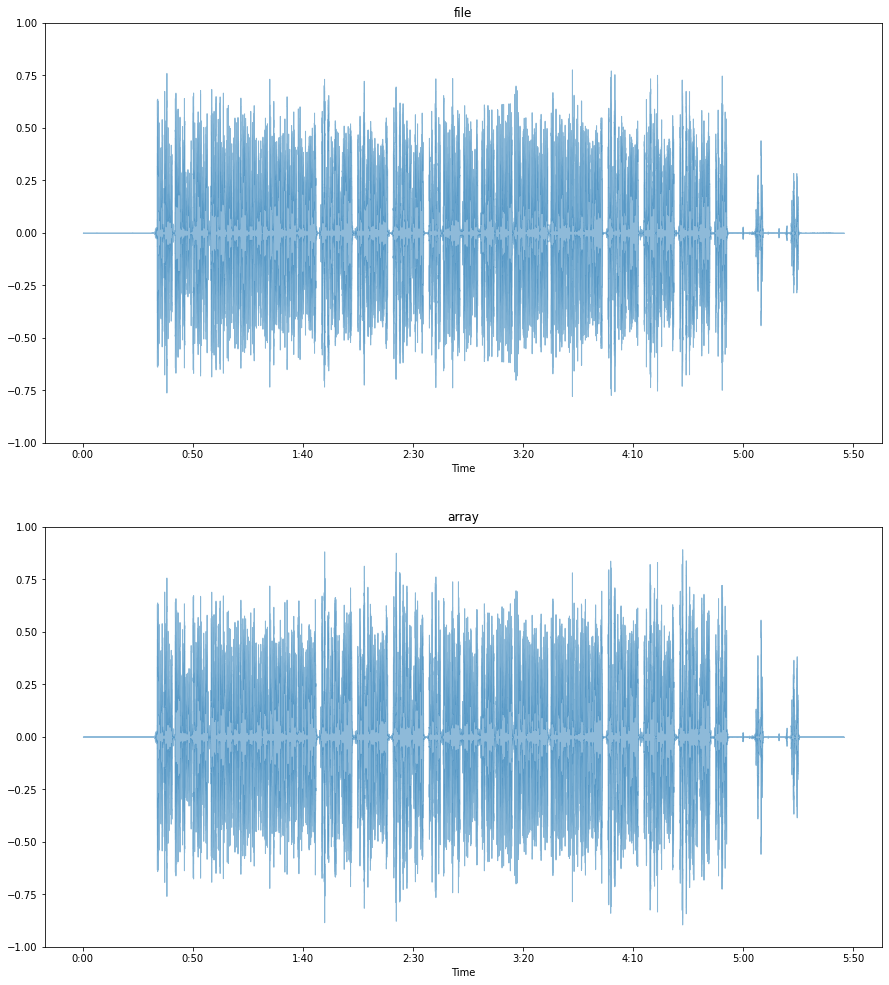

In [101]:
plt.figure(figsize=(15, 17))

plt.subplot(2, 1, 1)
librosa.display.waveshow(letai, alpha=0.5)
plt.title("file")
plt.ylim((-1, 1))

plt.subplot(2, 1, 2)
librosa.display.waveshow(prediction_letai["vocals"][:, 0], alpha=0.5)
plt.title("array")
plt.ylim((-1, 1))

In [113]:
prediction_letai["vocals"][1000000:]

array([[ 1.4767030e-01,  1.4420040e-01],
       [ 1.0519151e-01,  1.0351014e-01],
       [ 8.3681226e-02,  8.3267547e-02],
       ...,
       [-1.1620512e-07, -1.0495132e-07],
       [-1.1296812e-07, -1.0915653e-07],
       [-8.4651383e-08, -9.7322108e-08]], dtype=float32)

In [112]:
letai[1000000:]

array([0.14593506, 0.10435486, 0.08348083, ..., 0.        , 0.        ,
       0.        ], dtype=float32)

In [114]:
(1.4767030e-01 + 1.4420040e-01)/2

0.14593535000000002

In [118]:
(letai - ((prediction_letai["vocals"][:, 0] + prediction_letai["vocals"][:, 1])/2)).max()

1.5258789e-05